<a href="https://colab.research.google.com/github/TUM-XING/Mask-RCNN-microscopy/blob/main/Copy_of_Thesis_code.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Install Detectron2


In [ ]:
# install dependencies: 
!pip install pyyaml==5.1
!pip install torch==1.7.1 torchvision==0.8.2
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

     |████████████████████████████████| 276kB 8.3MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44074 sha256=0e434ba14cc65583f2558ca9bf3a7ad4aa7ff1ea3d522538415b5273c91128e6
  Stored in directory: /root/.cache/pip/wheels/ad/56/bc/1522f864feb2a358ea6f1a92b4798d69ac783a28e80567a18b
Successfully built pyyaml
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
     |████████████████████████████████| 776.8MB 23kB/s 
     |████████████████████████████████| 12.8MB 252kB/s 
ERROR: torchtext 0.9.0 has requirement torch==1.8.0, but you'll have torch 1.7.1 which is incompatible.
  Found existing installation: torch 1.8.0+cu101
    Uninstalling torch-1.8.0+cu101:
      Successfully uninstalled torch-1.8.0+cu101
  Found existing installation: torchvision 0.9.0+cu101
    Uninstalling torchvision-0.9.0+cu101:
      Successfully uninstalled torchvision-0.9.0+cu101
1.7.1 True
gcc (Ubuntu 7.5.0-3ubunt

In [ ]:
# install detectron2: (Colab has CUDA 10.1 + torch 1.7)
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
import torch
assert torch.__version__.startswith("1.7")   # need to manually install torch 1.7 if Colab changes its default version
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html
# exit(0)  # After installation, you need to "restart runtime" in Colab. This line can also restart runtime

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html
     |████████████████████████████████| 6.8MB 5.7MB/s 
     |████████████████████████████████| 2.2MB 7.7MB/s 
     |████████████████████████████████| 51kB 7.4MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.3.post20210311-cp37-none-any.whl size=58461 sha256=5c1ffcf0f0edb427d392d7fa5850df0b549795ac28b57d07dcb7e316f74f5f07
  Stored in directory: /root/.cache/pip/wheels/bc/cc/93/e011d6b86d91631d948f9bda94d60b82b51302192eb8a688c8
  Created wheel for iopath: filename=iopath-0.1.6-cp37-none-any.whl size=18269 sha256=a882fc27e76dd89dd6425c7231f510f4f3382d2b95f5cb3358fb35368df8c6df
  Stored in directory: /root/.cache/pip/wheels/ff/87/55/7513122394822977f993e1798bfebb46730d6183df8db7b283
Successfully built fvcore iopath
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: Pillow 7.0.0
    Uninstalling P

In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

** fvcore version of PathManager will be deprecated soon. **
** Please migrate to the version in iopath repo. **
https://github.com/facebookresearch/iopath 

** fvcore version of PathManager will be deprecated soon. **
** Please migrate to the version in iopath repo. **
https://github.com/facebookresearch/iopath 



# Download the dataset

> Văn bản được thụt lề



In [ ]:
!wget https://github.com/datleeee/dataset/raw/main/thickness_images.zip
!unzip thickness_images.zip > /dev/null

--2021-03-14 20:58:33--  https://github.com/datleeee/dataset/raw/main/thickness_images.zip
Resolving github.com (github.com)... 192.30.255.113
Connecting to github.com (github.com)|192.30.255.113|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/datleeee/dataset/main/thickness_images.zip [following]
--2021-03-14 20:58:33--  https://raw.githubusercontent.com/datleeee/dataset/main/thickness_images.zip
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 25759551 (25M) [application/zip]
Saving to: ‘thickness_images.zip’

thickness_images.zi 100%[===================>]  24.57M  83.5MB/s    in 0.3s    

2021-03-14 20:58:35 (83.5 MB/s) - ‘thickness_images.zip’ saved [25759551/25759551]



In [ ]:
!ls 'thickness_images'

labelme2coco.py  train	train.json  val  val.json


# Register the data 
The dataset is registered from COCO-format to 'Instances'

In [ ]:
from detectron2.data.datasets import register_coco_instances

for d in ["train", "val"]:
  register_coco_instances(f"thickness_{d}", {}, f"thickness_images/{d}.json", f"thickness_images/{d}")

To verify the data loading is correct, I visualize 5 random training images from the training dataset 

WARNING [03/14 20:58:42 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[03/14 20:58:42 d2.data.datasets.coco]: Loaded 23 images in COCO format from thickness_images/train.json


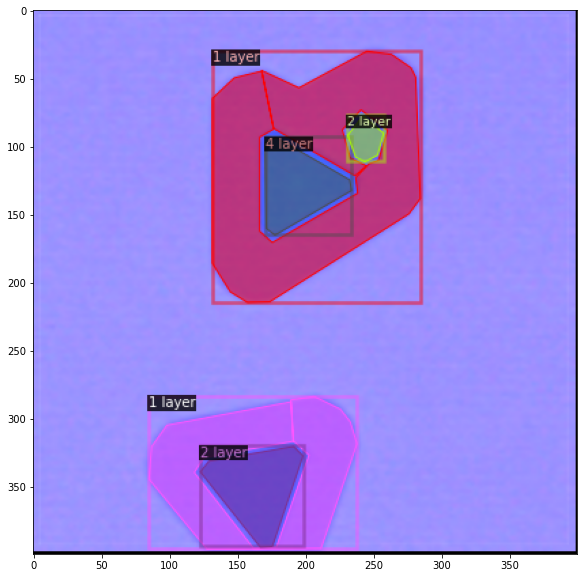

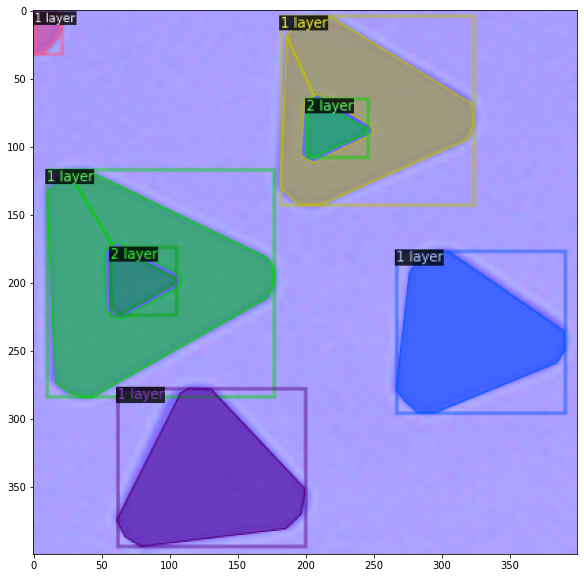

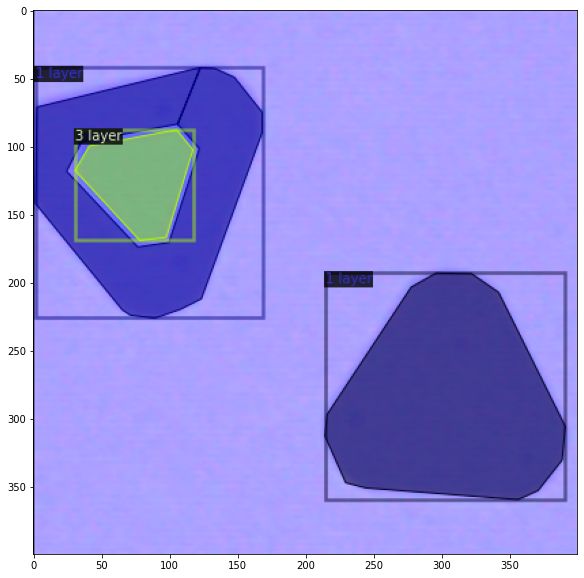

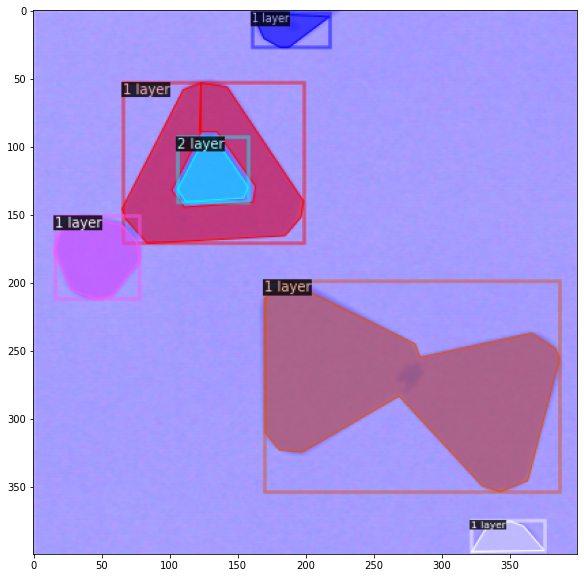

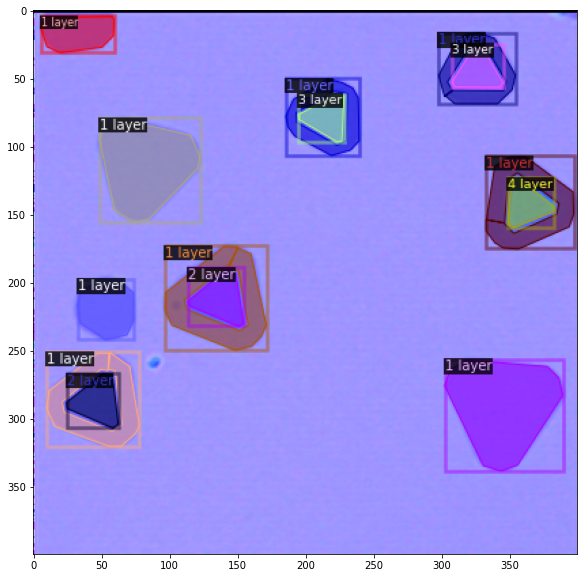

In [ ]:
import random
from detectron2.data import DatasetCatalog, MetadataCatalog

dataset_dicts = DatasetCatalog.get("thickness_train")
thickness_metadata = MetadataCatalog.get("thickness_train")

for d in random.sample(dataset_dicts, 5):
    img = cv2.imread(d["file_name"])
    v = Visualizer(img[:, :, ::-1], metadata=thickness_metadata, scale=0.5)
    v = v.draw_dataset_dict(d)
    plt.figure(figsize = (14, 10))
    plt.imshow(cv2.cvtColor(v.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
    plt.show()

# Training


In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import os
import torch


cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("thickness_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2              # Batch size
cfg.SOLVER.BASE_LR = 0.00025              # Learning rate
cfg.SOLVER.MAX_ITER = 2000                # Number of training iterations
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 4       # Number of classes

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[03/14 20:58:53 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f10217.pkl: 178MB [00:02, 87.4MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (5, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (5,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (16, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (16,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to

[03/14 20:58:57 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/detectron2/structures/masks.py:345: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/usr/local/lib/python3.7/dist-packages/detectron2/structures/masks.py:345: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/usr/local/lib/python3.7/dist-packages/detectron2/modeling/roi_heads/fast_rcnn.py:217: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/

[03/14 20:59:05 d2.utils.events]:  eta: 0:12:57  iter: 19  total_loss: 3.203  loss_cls: 1.667  loss_box_reg: 0.5131  loss_mask: 0.6992  loss_rpn_cls: 0.2056  loss_rpn_loc: 0.02014  time: 0.3995  data_time: 0.0152  lr: 4.9953e-06  max_mem: 2247M
[03/14 20:59:13 d2.utils.events]:  eta: 0:13:24  iter: 39  total_loss: 2.908  loss_cls: 1.424  loss_box_reg: 0.5774  loss_mask: 0.6923  loss_rpn_cls: 0.1928  loss_rpn_loc: 0.02179  time: 0.4078  data_time: 0.0054  lr: 9.9902e-06  max_mem: 2332M
[03/14 20:59:22 d2.utils.events]:  eta: 0:13:32  iter: 59  total_loss: 2.59  loss_cls: 1.066  loss_box_reg: 0.6662  loss_mask: 0.6798  loss_rpn_cls: 0.1256  loss_rpn_loc: 0.02282  time: 0.4156  data_time: 0.0047  lr: 1.4985e-05  max_mem: 2489M
[03/14 20:59:31 d2.utils.events]:  eta: 0:13:38  iter: 79  total_loss: 2.213  loss_cls: 0.7745  loss_box_reg: 0.679  loss_mask: 0.6559  loss_rpn_cls: 0.05807  loss_rpn_loc: 0.01895  time: 0.4221  data_time: 0.0051  lr: 1.998e-05  max_mem: 2489M
[03/14 20:59:40 d2.ut

# Check all relevanted training curves

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

# Save trained model

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5 
cfg.DATASETS.TEST = ("thickness_val", )
predictor = DefaultPredictor(cfg)

# Inference and evaluation the model

Visualise 8 annotated images from validation/test dataset

WARNING [03/14 21:18:04 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[03/14 21:18:04 d2.data.datasets.coco]: Loaded 8 images in COCO format from thickness_images/val.json


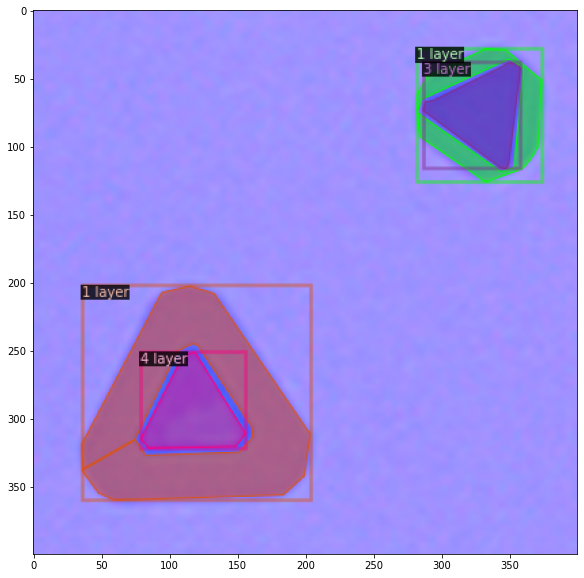

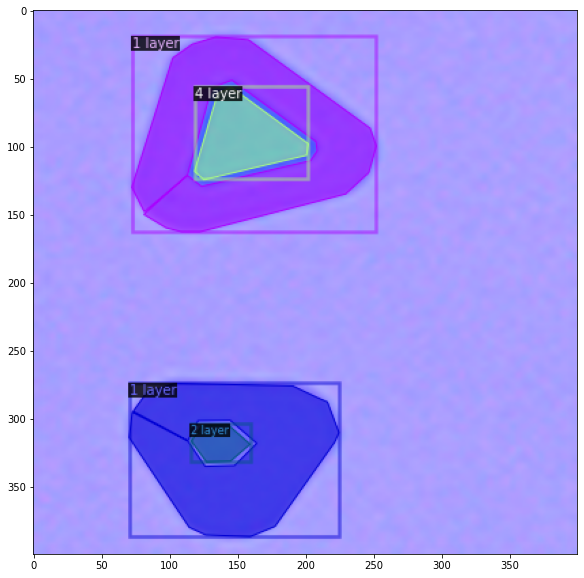

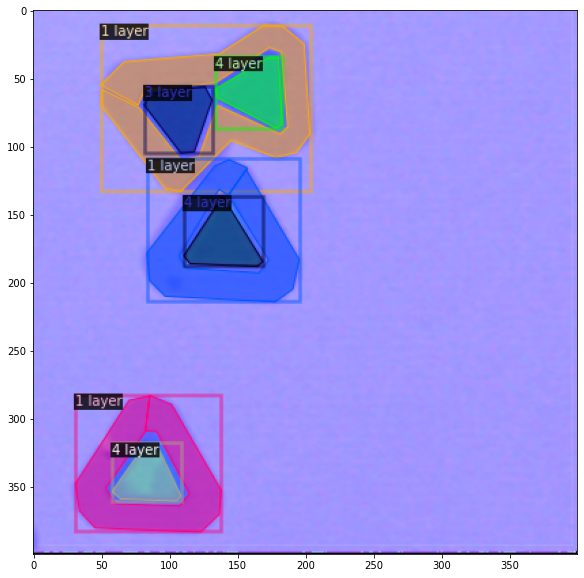

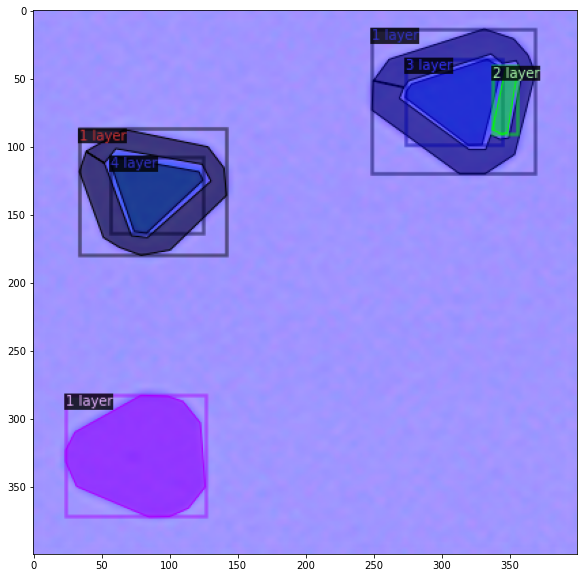

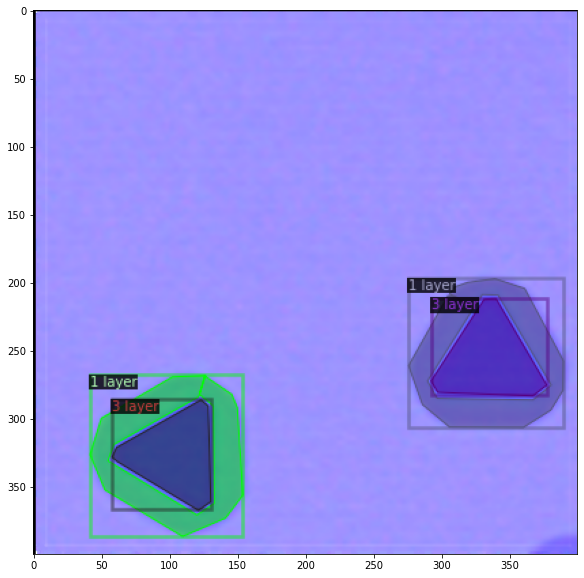

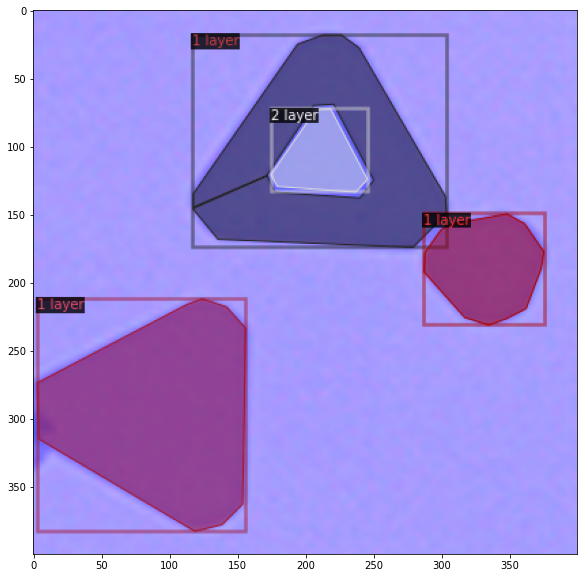

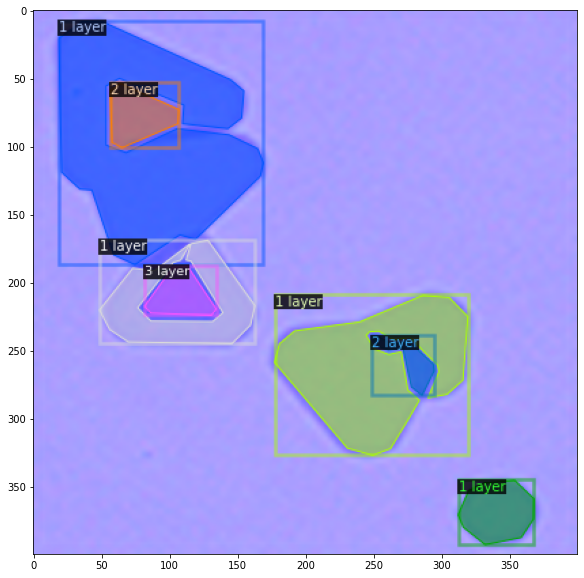

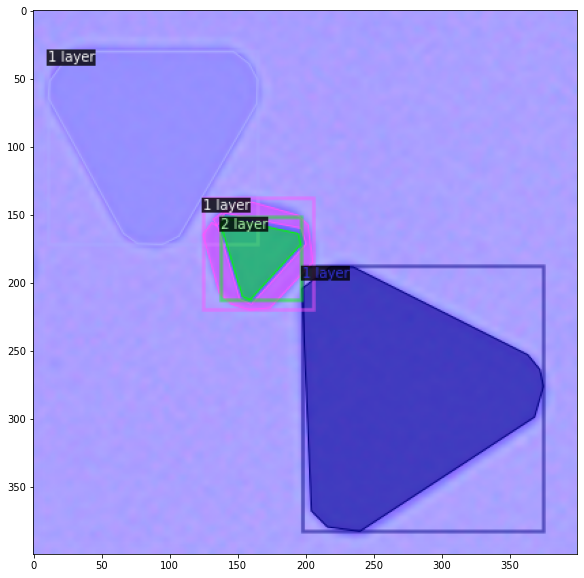

In [ ]:
dataset_dicts = DatasetCatalog.get("thickness_val")
thickness_metadata = MetadataCatalog.get("thickness_val")

for d in random.sample(dataset_dicts, 8):
    img = cv2.imread(d["file_name"])
    v = Visualizer(img[:, :, ::-1], metadata=thickness_metadata, scale=0.5)
    v = v.draw_dataset_dict(d)
    plt.figure(figsize = (14, 10))
    plt.imshow(cv2.cvtColor(v.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
    plt.show()

Visualise 8 predicted results from validation/test dataset

WARNING [03/14 21:18:50 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[03/14 21:18:50 d2.data.datasets.coco]: Loaded 8 images in COCO format from thickness_images/val.json


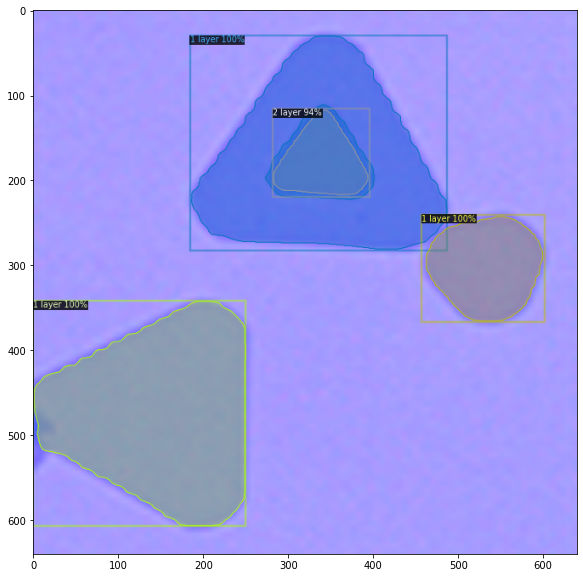

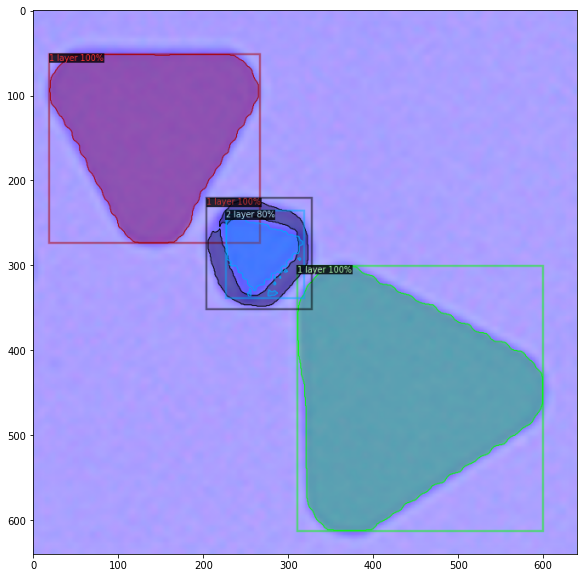

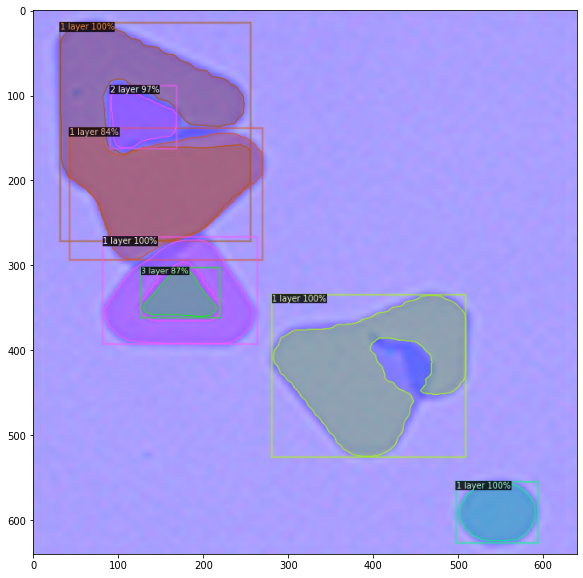

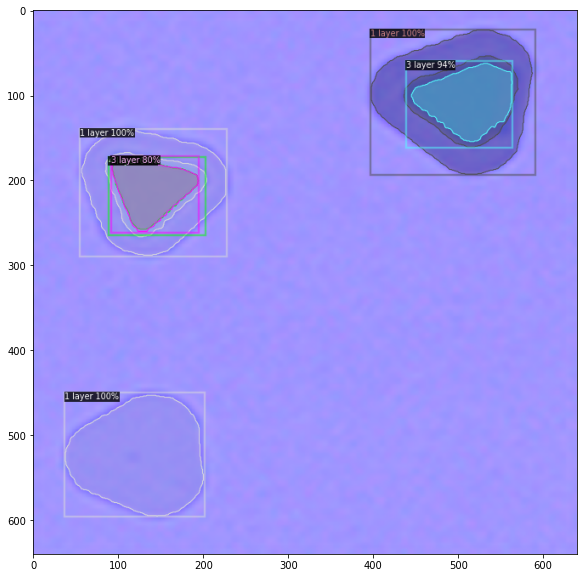

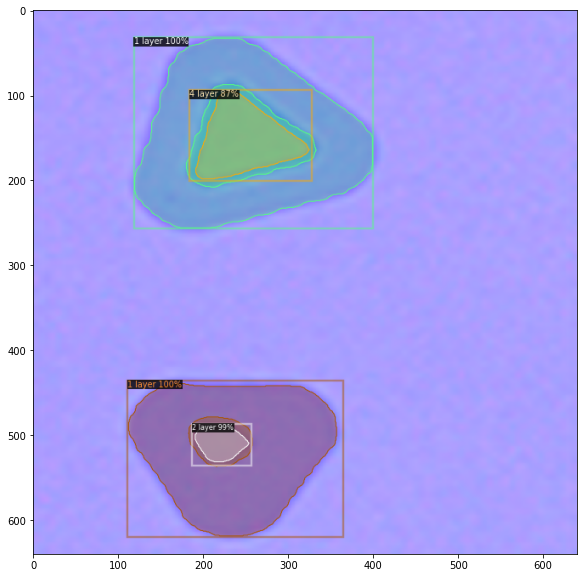

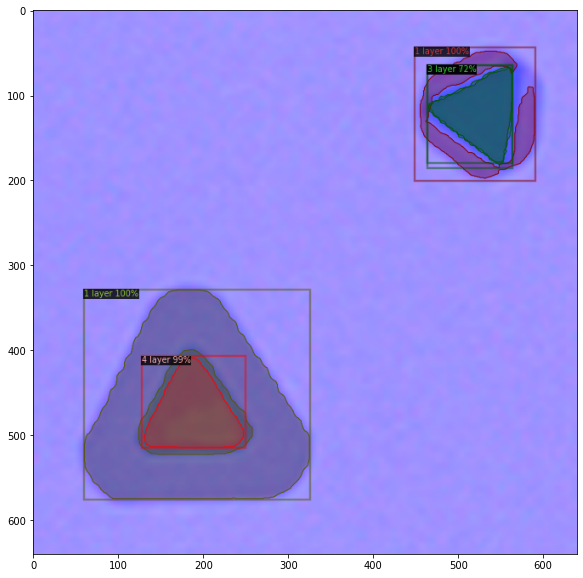

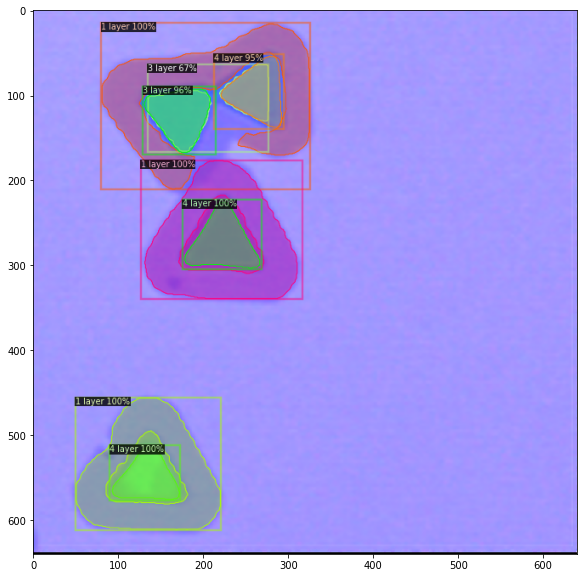

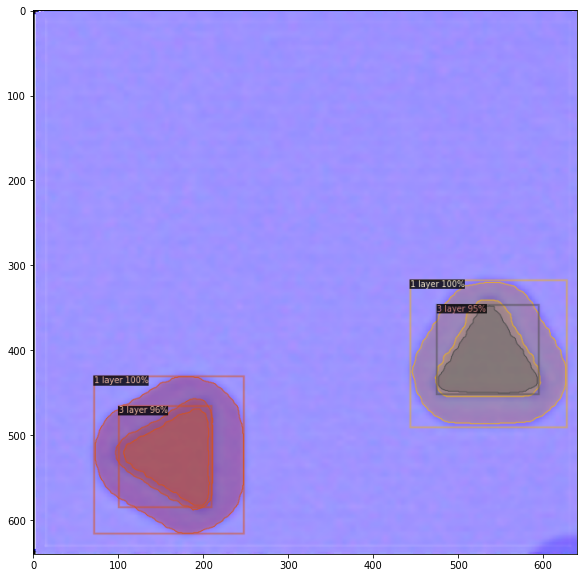

In [ ]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = DatasetCatalog.get("thickness_val")
for d in random.sample(dataset_dicts, 8):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=thickness_metadata, 
                   scale=0.8, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.figure(figsize = (14, 10))
    plt.imshow(cv2.cvtColor(v.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
    plt.show()

# Evaluate the performance of model

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("thickness_val", ("bbox", "segm"), False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "thickness_val")
print(inference_on_dataset(trainer.model, val_loader, evaluator))
# another equivalent way to evaluate the model is to use `trainer.test`

WARNING [03/14 21:23:00 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[03/14 21:23:00 d2.data.datasets.coco]: Loaded 8 images in COCO format from thickness_images/val.json
[03/14 21:23:00 d2.data.build]: Distribution of instances among all 4 categories:
|  category  | #instances   |  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|:----------:|:-------------|
|  1 layer   | 22           |  2 layer   | 6            |  3 layer   | 6            |
|  4 layer   | 6            |            |              |            |              |
|   total    | 40           |            |              |            |              |
[03/14 21:23:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[03/14 21:23:00 d2.data.common]: Serializing 8 elements to byte tenso